<a href="https://colab.research.google.com/github/rohammaiti/Comsys-Hackathon/blob/main/Comsys_Task_A.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!unzip -q /content/drive/MyDrive/Comys_Hackathon5.zip -d /content/Comys_Hackathon5

In [ ]:
!sudo pip3 install keras
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import os
import sys
import random
import shutil
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score
from tensorflow.keras import applications, models, layers, callbacks, optimizers
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.preprocessing import image_dataset_from_directory

In [ ]:
base_path = '/content/Comys_Hackathon5'
image_extensions = ('.jpg', '.jpeg', '.png', '.webp', '.jfif', '.bmp')

for root, dirs, files in os.walk(base_path):
    img_count = len([f for f in files if f.lower().endswith(image_extensions)])
    if img_count > 0 or len(dirs) > 0:
        print(f"Folder: {root}")
        print(f"  Image files: {img_count}")


Folder: /content/Comys_Hackathon5
  Image files: 0
Folder: /content/Comys_Hackathon5/Comys_Hackathon5
  Image files: 0
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B
  Image files: 0
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train
  Image files: 0
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train/Svend_Aage_Jensby
  Image files: 1
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train/Svend_Aage_Jensby/distortion
  Image files: 7
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train/Mohammed_Ashraf_Hafiz
  Image files: 1
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train/Mohammed_Ashraf_Hafiz/distortion
  Image files: 7
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train/Jon_Gruden
  Image files: 7
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train/Jon_Gruden/distortion
  Image files: 49
Folder: /content/Comys_Hackathon5/Comys_Hackathon5/Task_B/train/Dusty_Baker
  Image files: 1
Folder: /c

In [ ]:
base_path = '/content/Comys_Hackathon5'
image_extensions = ('.jpg', '.jpeg', '.png', '.webp', '.jfif', '.bmp', '.bmp')

def print_tree(path, prefix=''):
    files = os.listdir(path)
    img_count = len([f for f in files if f.lower().endswith(image_extensions)])

    print(f"{prefix}{os.path.basename(path)}/ ({img_count} images)")

    for f in sorted(files):
        full_path = os.path.join(path, f)
        if os.path.isdir(full_path):
            print_tree(full_path, prefix + '  ')

print_tree(base_path)

Comys_Hackathon5/ (0 images)
  Comys_Hackathon5/ (0 images)
    Task_A/ (0 images)
      train/ (0 images)
        female/ (394 images)
        male/ (1532 images)
      val/ (0 images)
        female/ (105 images)
        male/ (317 images)
    Task_B/ (0 images)
      train/ (0 images)
        001_frontal/ (1 images)
          distortion/ (7 images)
        002_frontal/ (1 images)
          distortion/ (7 images)
        003_frontal/ (1 images)
          distortion/ (7 images)
        004_frontal/ (1 images)
          distortion/ (7 images)
        005_frontal/ (1 images)
          distortion/ (7 images)
        007_frontal/ (1 images)
          distortion/ (7 images)
        008_frontal/ (1 images)
          distortion/ (7 images)
        010_frontal/ (1 images)
          distortion/ (7 images)
        011_frontal/ (1 images)
          distortion/ (7 images)
        012_frontal/ (1 images)
          distortion/ (7 images)
        013_frontal/ (1 images)
          distortion/ (7 imag

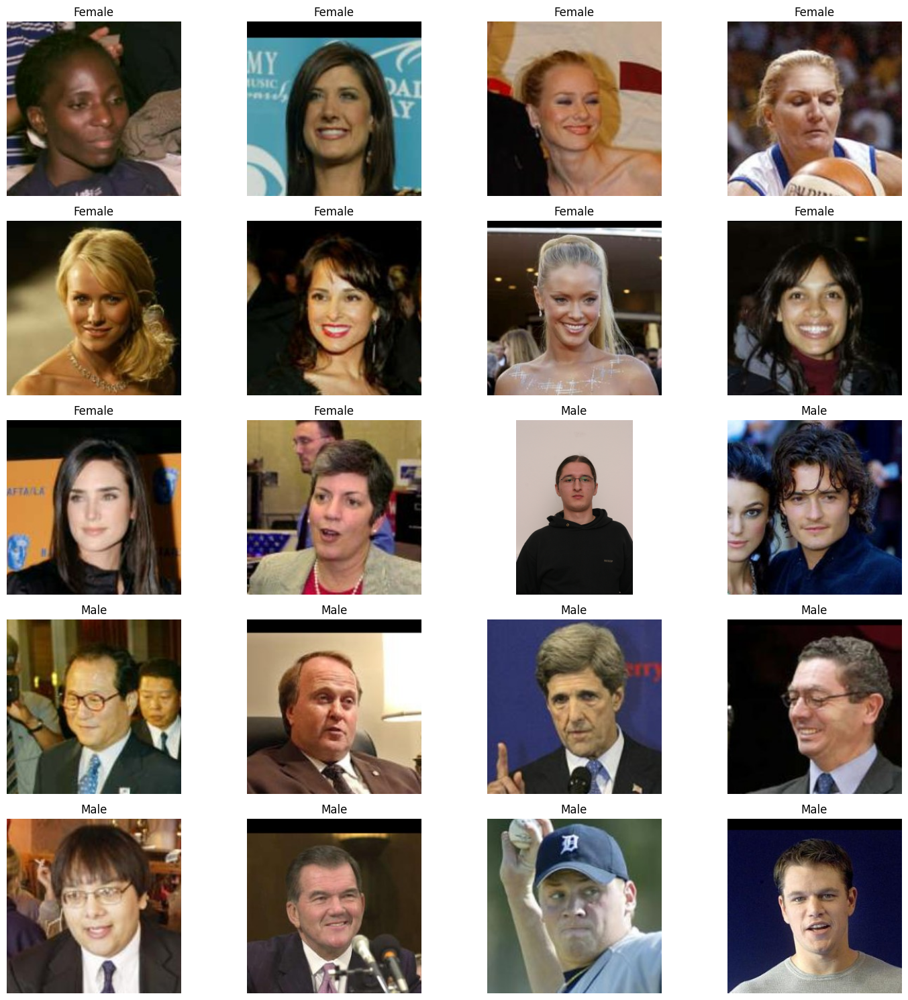

In [ ]:
base_path = '/content/Comys_Hackathon5/Comys_Hackathon5/Task_A/train'
female_path = os.path.join(base_path, 'female')
male_path = os.path.join(base_path, 'male')

female_images = [os.path.join(female_path, f) for f in os.listdir(female_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.webp', '.jfif', '.bmp'))]
male_images = [os.path.join(male_path, f) for f in os.listdir(male_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.webp', '.jfif', '.bmp'))]

female_samples = random.sample(female_images, min(10, len(female_images)))
male_samples = random.sample(male_images, min(10, len(male_images)))

all_samples = female_samples + male_samples

fig, axes = plt.subplots(5, 4, figsize=(15, 15))
axes = axes.flatten()

for img_path, ax in zip(all_samples, axes):
    img = mpimg.imread(img_path)
    ax.imshow(img)
    label = 'Female' if 'female' in img_path else 'Male'
    ax.set_title(label)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
train_dir = "/content/Comys_Hackathon5/Comys_Hackathon5/Task_A/train"
val_dir = "/content/Comys_Hackathon5/Comys_Hackathon5/Task_A/val"

img_size = (224, 224)
batch_size = 32

data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
    layers.RandomContrast(0.1),
])

train_ds = image_dataset_from_directory(
    train_dir,
    labels='inferred',
    label_mode='binary',
    batch_size=batch_size,
    image_size=img_size,
    shuffle=True
)

val_ds = image_dataset_from_directory(
    val_dir,
    labels='inferred',
    label_mode='binary',
    batch_size=batch_size,
    image_size=img_size,
    shuffle=False
)

normalization_layer = layers.Rescaling(1./255)

augmented_train_ds = train_ds.map(lambda x, y: (normalization_layer(data_augmentation(x)), y))

val_ds = val_ds.map(lambda x, y: (normalization_layer(x), y))

AUTOTUNE = tf.data.AUTOTUNE
augmented_train_ds = augmented_train_ds.prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.prefetch(buffer_size=AUTOTUNE)

Found 1926 files belonging to 2 classes.
Found 422 files belonging to 2 classes.


In [ ]:
base_model = tf.keras.applications.DenseNet169(
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dropout(0.3),
    layers.Dense(1, activation='sigmoid')
])

model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='binary_crossentropy',
    metrics=['accuracy']
)

labels = []
for _, y in train_ds.unbatch():
    labels.append(int(y.numpy()))
labels = np.array(labels)

from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(labels),
    y=labels
)
class_weight_dict = {i: class_weights[i] for i in range(len(class_weights))}

callbacks = [
    tf.keras.callbacks.ModelCheckpoint(
        "densenet169_gender_best.keras",
        save_best_only=True,
        monitor="val_accuracy",
        mode="max"
    )
]

history = model.fit(
    augmented_train_ds,
    validation_data=val_ds,
    epochs=50,
    class_weight=class_weight_dict,
    callbacks=callbacks
)

model.save("densenet169_model.keras")

51877672/51877672 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


/tmp/ipython-input-7-887545070.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  labels.append(int(y.numpy()))


Epoch 1/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 116s 1s/step - accuracy: 0.5721 - loss: 0.6897 - val_accuracy: 0.8578 - val_loss: 0.3235
Epoch 2/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 76s 512ms/step - accuracy: 0.8396 - loss: 0.3839 - val_accuracy: 0.8815 - val_loss: 0.2770
Epoch 3/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 33s 533ms/step - accuracy: 0.8695 - loss: 0.3239 - val_accuracy: 0.8934 - val_loss: 0.2548
Epoch 4/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 42s 536ms/step - accuracy: 0.8806 - loss: 0.3232 - val_accuracy: 0.9052 - val_loss: 0.2448
Epoch 5/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 31s 506ms/step - accuracy: 0.8806 - loss: 0.2783 - val_accuracy: 0.9028 - val_loss: 0.2380
Epoch 6/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 40s 496ms/step - accuracy: 0.8808 - loss: 0.2810 - val_accuracy: 0.9028 - val_loss: 0.2335
Epoch 7/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 43s 532ms/step - accuracy: 0.8994 - loss: 0.2521 - val_accuracy: 0.9100 - val_loss: 0.2308
Epoch 8/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 30s 490ms/step - accuracy: 0.9121 - loss: 0.2385 - val_accura

In [ ]:
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ densenet169 (Functional)        │ (None, 7, 7, 1664)     │    12,642,880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1664)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1664)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │         1,665 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 12,647,877 (48.25 MB)

 Trainable params: 1,665 (6.50 KB)

 Non-trainable params: 12,642,880 (48.23 MB)

 Optimizer params: 3,332 (13.02 KB)

In [ ]:
densenet_model = tf.keras.models.load_model("densenet169_gender_best.keras")
loss, acc = densenet_model.evaluate(val_ds, verbose=0)
print("DenseNet169 validation accuracy: %.2f%%" % (acc * 100))

DenseNet169 validation accuracy: 91.71%


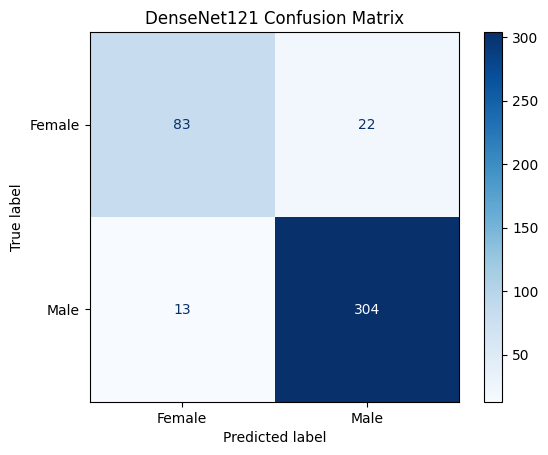

In [ ]:
densenet_model = tf.keras.models.load_model("densenet169_gender_best.keras")
y_true = []
y_pred = []

for images, labels in val_ds.unbatch():
    img = tf.expand_dims(images, axis=0)
    y_true.append(int(labels.numpy().item()))

    den_pred = densenet_model.predict(img, verbose=0)
    y_pred.append(int(den_pred[0][0] > 0.5))

def plot_conf_matrix(y_true, y_pred, title):
    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Female', 'Male'])
    disp.plot(cmap=plt.cm.Blues)
    plt.title(title)
    plt.show()

plot_conf_matrix(y_true, y_pred, "DenseNet121 Confusion Matrix")

In [ ]:
report = classification_report(y_true, y_pred, target_names=['Female', 'Male'])
print(report)

              precision    recall  f1-score   support

      Female       0.86      0.79      0.83       105
        Male       0.93      0.96      0.95       317

    accuracy                           0.92       422
   macro avg       0.90      0.87      0.89       422
weighted avg       0.92      0.92      0.92       422



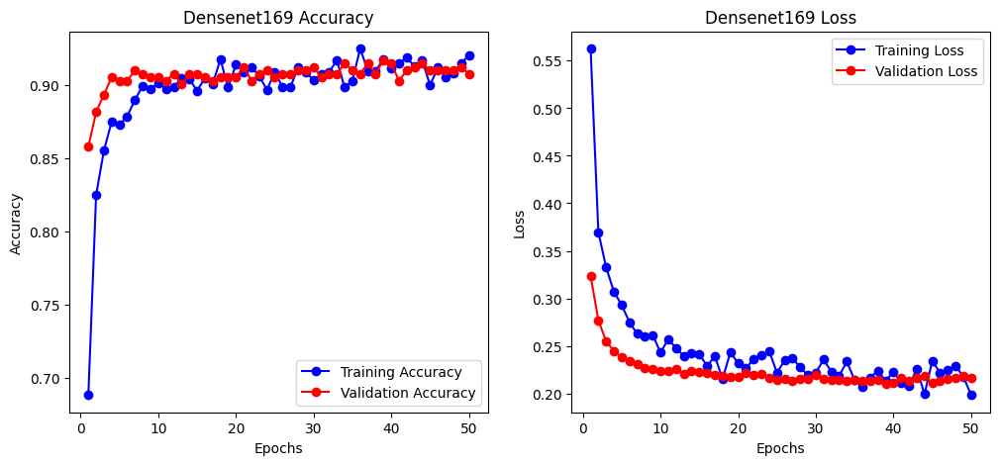

In [ ]:
def plot_history(history, model_name):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(acc) + 1)

    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, acc, 'bo-', label='Training Accuracy')
    plt.plot(epochs, val_acc, 'ro-', label='Validation Accuracy')
    plt.title(f'{model_name} Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, loss, 'bo-', label='Training Loss')
    plt.plot(epochs, val_loss, 'ro-', label='Validation Loss')
    plt.title(f'{model_name} Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()

plot_history(history, "Densenet169")

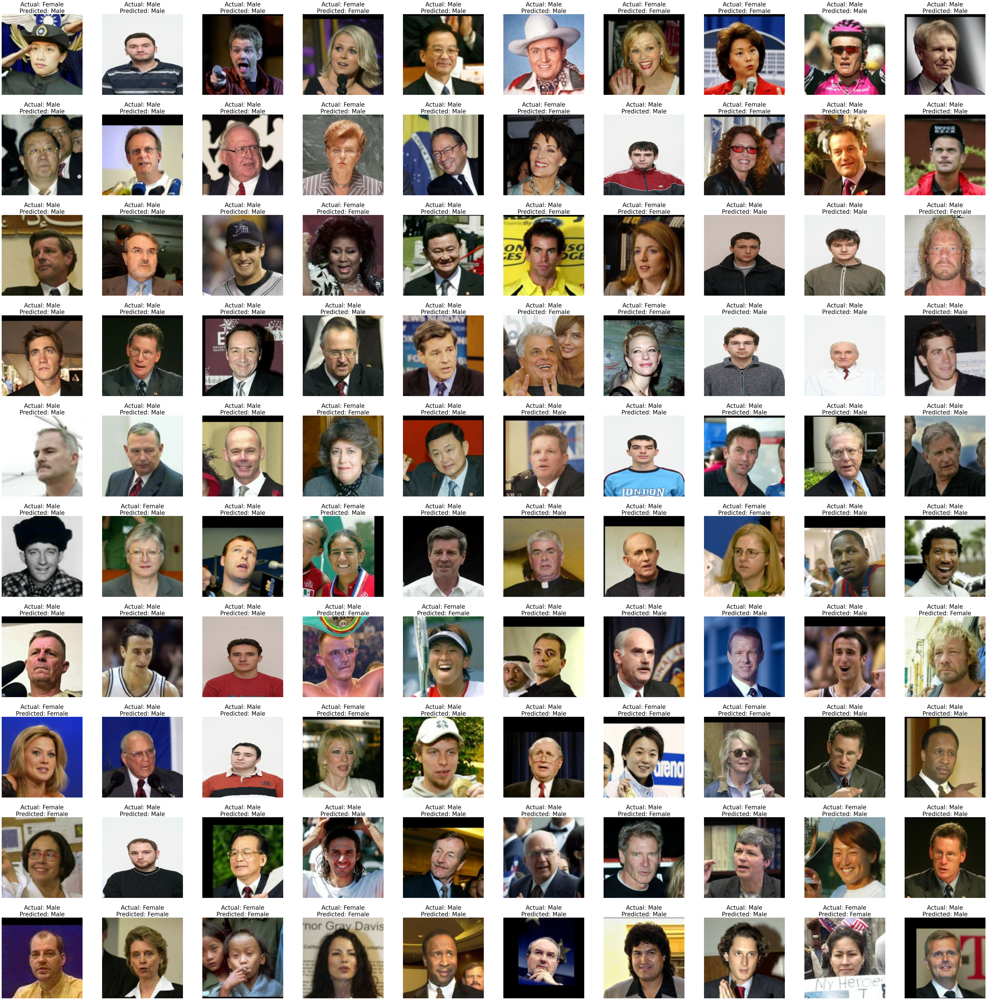

In [ ]:
def decode_label(label):
    return 'Male' if label == 1 else 'Female'

sample_images = []
sample_labels = []
count = 0

for images, labels in val_ds.unbatch().shuffle(10000):
    if count >= 100:
        break
    sample_images.append(images.numpy())
    sample_labels.append(int(labels.numpy().item()))
    count += 1

sample_images_np = np.stack(sample_images)

densenet_model = tf.keras.models.load_model("densenet169_gender_best.keras")

pred_probs = densenet_model.predict(sample_images_np, verbose=0)
pred_labels = (pred_probs > 0.5).astype(int).flatten()

rows, cols = 10, 10
plt.figure(figsize=(60, 60))

for i in range(100):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(sample_images[i])
    plt.axis('off')
    plt.title(f"Actual: {decode_label(sample_labels[i])}\nPredicted: {decode_label(pred_labels[i])}", fontsize=25)

plt.tight_layout(pad=3)
plt.show()

In [ ]:
def evaluate_model(model_path, test_data_path, img_size=(224, 224), batch_size=32):
    if not os.path.isdir(test_data_path):
        print(f"Error: Test data path not found or is not a directory: {test_data_path}")
        return None

    try:
        model = tf.keras.models.load_model(model_path)
        print(f"Model loaded successfully from {model_path}")
    except Exception as e:
        print(f"Error loading model from {model_path}: {e}")
        return None

    try:
        test_ds = tf.keras.utils.image_dataset_from_directory(
            test_data_path,
            labels='inferred',
            label_mode='binary',
            batch_size=batch_size,
            image_size=img_size,
            shuffle=False
        )
        normalization_layer = tf.keras.layers.Rescaling(1./255)
        test_ds = test_ds.map(lambda x, y: (normalization_layer(x), y))

        AUTOTUNE = tf.data.AUTOTUNE
        test_ds = test_ds.prefetch(buffer_size=AUTOTUNE)

        print(f"Test dataset loaded from {test_data_path}")

    except Exception as e:
        print(f"Error loading test dataset from {test_data_path}: {e}")
        return None

    y_true = []
    y_pred_probs = model.predict(test_ds)
    y_pred = (y_pred_probs > 0.5).astype(int).flatten()

    for _, labels in test_ds.unbatch():
        y_true.append(int(labels.numpy().item()))

    y_true = np.array(y_true)

    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)

    print("\n--- Evaluation Metrics ---")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")

    print("\n--- Classification Report ---")
    target_names = ['Female', 'Male']
    print(classification_report(y_true, y_pred, target_names=target_names))

    metrics = {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1_score": f1
    }

    return metrics

model_file = "densenet169_gender_best.keras"
test_data_directory = "/content/Comys_Hackathon5/Comys_Hackathon5/Task_A/val"

if os.path.exists(model_file):
    evaluation_metrics = evaluate_model(model_file, test_data_directory)

    if evaluation_metrics:
        print("\nEvaluation Complete.")

else:
    print(f"Error: Model file not found at {model_file}")
    print("Please make sure the model path is correct.")

Model loaded successfully from densenet169_gender_best.keras
Found 422 files belonging to 2 classes.
Test dataset loaded from /content/Comys_Hackathon5/Comys_Hackathon5/Task_A/val
14/14 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step

--- Evaluation Metrics ---
Accuracy: 0.9171
Precision: 0.9325
Recall: 0.9590
F1-Score: 0.9456

--- Classification Report ---
              precision    recall  f1-score   support

      Female       0.86      0.79      0.83       105
        Male       0.93      0.96      0.95       317

    accuracy                           0.92       422
   macro avg       0.90      0.87      0.89       422
weighted avg       0.92      0.92      0.92       422


Evaluation Complete.


Use the above code to enter path of the test directory to get accuracy, precision, recall and f1 score of the model that is built here. One can also upload any image from the local system to classify the person in the image as male or female.

Model loaded successfully from densenet169_gender_best.keras


Saving formalpicture.jpeg to formalpicture.jpeg
1/1 ━━━━━━━━━━━━━━━━━━━━ 15s 15s/step

Uploaded image: formalpicture.jpeg
Prediction: Male (Confidence: 0.9978)


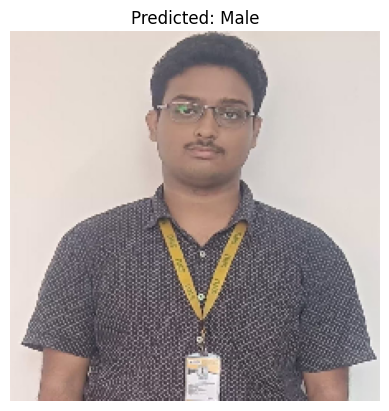

In [ ]:
from google.colab import files
from tensorflow.keras.preprocessing import image

def predict_image(model_path="densenet169_gender_best.keras", img_size=(224, 224)):
    """
    Uploads an image, predicts its gender using a pre-trained model,
    and displays the image with the prediction.

    Args:
        model_path (str): Path to the saved Keras model file.
        img_size (tuple): Target size for resizing the input image.
    """
    try:
        model = tf.keras.models.load_model(model_path)
        print(f"Model loaded successfully from {model_path}")
    except Exception as e:
        print(f"Error loading model from {model_path}: {e}")
        return

    uploaded = files.upload()

    for fn in uploaded.keys():
        img_path = fn
        try:
            img = image.load_img(img_path, target_size=img_size)
            img_array = image.img_to_array(img)
            img_array = np.expand_dims(img_array, axis=0)
            img_array /= 255.0

            predictions = model.predict(img_array)
            predicted_class = (predictions > 0.5).astype(int)[0][0]

            decoded_prediction = 'Male' if predicted_class == 1 else 'Female'
            confidence = predictions[0][0] if predicted_class == 1 else (1 - predictions[0][0])


            print(f"\nUploaded image: {fn}")
            print(f"Prediction: {decoded_prediction} (Confidence: {confidence:.4f})")


            plt.imshow(img)
            plt.title(f"Predicted: {decoded_prediction}")
            plt.axis('off')
            plt.show()
        except Exception as e:
            print(f"Error processing image {fn}: {e}")


predict_image()